Let's Do Data Analysis!
====================
## Where's ya data from?
- [Right here, baby!](https://github.com/Ayushijain09/Regression-on-COVID-dataset)

## Goals
- I was trying to see whether or not we could chart Covid-19 infectivity amongst various demographics.
- Honestly? Things turned out a bit better than I expected.

## Methodology
- Did Data preprocessing, specifically data cleaning and scaling.
- Tried a bunch of models mostly to see what would happen.
- Read some blog posts about this and got advice from a couple of teachers.

### Let's kick this off.

First things first, let's do the imports and get a look at the dataset we're messing around with.

In [199]:
#####!-! Imports !-!#####
import pandas as pd
import numpy as np
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import PolynomialFeatures
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score
from sklearn.metrics import confusion_matrix, f1_score
from sklearn.ensemble import RandomForestClassifier
import seaborn as sns
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore') 
#####!-! Let's Do Data !-!#####
data = pd.read_csv("COVID-19_Daily_Testing.csv")
pos_data = data
nonpos_data = data
data.head()

,Date,Day,Tests,Cases,People Not-Positive - Total,People Tested - Age 0-17,People Tested - Age 18-29,People Tested - Age 30-39,People Tested - Age 40-49,People Tested - Age 50-59,...,People Not-Positive - Age Unknown,People Not-Positive - Female,People Not-Positive - Male,People Not-Positive - Gender Unknown,People Not-Positive - Latinx,People Not-Positive - Asian Non-Latinx,People Not-Positive - Black Non-Latinx,People Not-Positive - White Non-Latinx,People Not-Positive - Other Race Non-Latinx,People Not-Positive - Unknown Race/Ethnicity
0,03-01-20,Sunday,1,0,1,0,0,1,0,0,...,0,0,1,0,0,0,0,1,0,0
1,05-02-20,Saturday,2431,705,1726,129,470,458,458,412,...,1,898,797,31,226,30,273,225,51,921
2,05/14/2020,Thursday,4098,772,3326,260,805,833,685,604,...,16,1654,1424,248,529,43,430,442,109,1773
3,03-05-20,Thursday,17,1,16,4,2,0,4,3,...,0,7,9,0,2,0,4,2,1,7
4,03-06-20,Friday,18,3,15,1,5,1,3,3,...,1,8,7,0,2,0,1,2,1,9


In [153]:
#####!-! Let's Look at Data !-!#####
data = data.drop
for col in df.columns:
    print(col)
    if type(df[col][0]) != np.int64:
        le = LabelEncoder()
        df[col] = le.fit_transform(df[col])

Tests
Cases
People Not-Positive - Total
People Tested - Age 0-17
People Tested - Age 18-29
People Tested - Age 30-39
People Tested - Age 40-49
People Tested - Age 50-59
People Tested - Age 60-69
People Tested - Age 70-79
People Tested - Age 80+
People Tested - Age Unknown
People Tested - Female
People Tested - Male
People Tested - Gender Unknown
People Tested - Latinx
People Tested - Asian Non-Latinx
People Tested - Black Non-Latinx
People Tested - White Non-Latinx
People Tested - Other Race Non-Latinx
People Tested - Unknown Race/Ethnicity
People Positive - Age 0-17
People Positive - Age 18-29
People Positive - Age 30-30
People Positive - Age 40-49
People Positive - Age 50-59
People Positive - Age 60-69
People Positive - Age 70-79
People Positive - Age 80+
People Positive - Age Unknown
People Positive - Female
People Positive - Male
People Positive - Gender Unknown
People Positive - Latinx
People Positive - Asian Non-Latinx
People Positive - Black Non-Latinx
People Positive - White No

In [149]:
print("This Covid-19 Dataset has {} data points with {} variables each.".format(*data.shape))
print("This dataset has {} recorded tests".format(data.Tests.sum()))
print("Of those tests, there are {} confirmed cases.".format(data.Cases.sum()))

This Covid-19 Dataset has 89 data points with 59 variables each.
This dataset has 192727 recorded tests
Of those tests, there are 44496 confirmed cases.


In [151]:
data['Cases'].describe()

count      89.000000
mean      499.955056
std       365.764266
min         0.000000
25%       169.000000
50%       460.000000
75%       768.000000
max      1285.000000
Name: Cases, dtype: float64

In [150]:
data['Tests'].describe()

count      89.00000
mean     2165.47191
std      1735.84995
min         1.00000
25%       801.00000
50%      1645.00000
75%      3818.00000
max      5971.00000
Name: Tests, dtype: float64

### Oof
That's... way too many columns. And there's an error. Let's fix that error and try sorting these into different dataframes.

In [201]:
data = data.rename(columns={'People Positive - Age 30-30':'People Positive - Age 30-39'})
data.head()

,Date,Day,Tests,Cases,People Not-Positive - Total,People Tested - Age 0-17,People Tested - Age 18-29,People Tested - Age 30-39,People Tested - Age 40-49,People Tested - Age 50-59,...,People Not-Positive - Age Unknown,People Not-Positive - Female,People Not-Positive - Male,People Not-Positive - Gender Unknown,People Not-Positive - Latinx,People Not-Positive - Asian Non-Latinx,People Not-Positive - Black Non-Latinx,People Not-Positive - White Non-Latinx,People Not-Positive - Other Race Non-Latinx,People Not-Positive - Unknown Race/Ethnicity
0,03-01-20,Sunday,1,0,1,0,0,1,0,0,...,0,0,1,0,0,0,0,1,0,0
1,05-02-20,Saturday,2431,705,1726,129,470,458,458,412,...,1,898,797,31,226,30,273,225,51,921
2,05/14/2020,Thursday,4098,772,3326,260,805,833,685,604,...,16,1654,1424,248,529,43,430,442,109,1773
3,03-05-20,Thursday,17,1,16,4,2,0,4,3,...,0,7,9,0,2,0,4,2,1,7
4,03-06-20,Friday,18,3,15,1,5,1,3,3,...,1,8,7,0,2,0,1,2,1,9


In [202]:
pos_data = data.drop(columns=['People Not-Positive - Age 0-17','People Not-Positive - Age 18-29','People Not-Positive - Age 30-39','People Not-Positive - Age 40-49','People Not-Positive - Age 50-59','People Not-Positive - Age 60-69','People Not-Positive - Age 70-79','People Not-Positive - Age 80+','People Not-Positive - Age Unknown','People Not-Positive - Female','People Not-Positive - Male','People Not-Positive - Gender Unknown','People Not-Positive - Latinx','People Not-Positive - Asian Non-Latinx','People Not-Positive - Black Non-Latinx','People Not-Positive - White Non-Latinx','People Not-Positive - Other Race Non-Latinx','People Not-Positive - Unknown Race/Ethnicity'])
nonpos_data = data.drop(columns=['People Positive - Age 0-17','People Positive - Age 18-29','People Positive - Age 30-39','People Positive - Age 40-49','People Positive - Age 50-59','People Positive - Age 60-69','People Positive - Age 70-79','People Positive - Age 80+','People Positive - Age Unknown','People Positive - Female','People Positive - Male','People Positive - Gender Unknown','People Positive - Latinx','People Positive - Asian Non-Latinx','People Positive - Black Non-Latinx','People Positive - White Non-Latinx','People Positive - Other Race Non-Latinx','People Positive - Unknown Race/Ethnicity'])

In [203]:
pos_data

,Date,Day,Tests,Cases,People Not-Positive - Total,People Tested - Age 0-17,People Tested - Age 18-29,People Tested - Age 30-39,People Tested - Age 40-49,People Tested - Age 50-59,...,People Positive - Age Unknown,People Positive - Female,People Positive - Male,People Positive - Gender Unknown,People Positive - Latinx,People Positive - Asian Non-Latinx,People Positive - Black Non-Latinx,People Positive - White Non-Latinx,People Positive - Other Race Non-Latinx,People Positive - Unknown Race/Ethnicity
0,03-01-20,Sunday,1,0,1,0,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0
1,05-02-20,Saturday,2431,705,1726,129,470,458,458,412,...,0,340,361,4,343,9,103,51,22,177
2,05/14/2020,Thursday,4098,772,3326,260,805,833,685,604,...,0,395,362,15,319,12,151,68,35,187
3,03-05-20,Thursday,17,1,16,4,2,0,4,3,...,0,1,0,0,0,0,1,0,0,0
4,03-06-20,Friday,18,3,15,1,5,1,3,3,...,0,0,3,0,0,0,0,3,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
84,04/26/2020,Sunday,1556,425,1131,89,305,292,245,237,...,0,221,201,3,147,16,86,56,23,97
85,03/17/2020,Tuesday,559,96,463,25,115,134,79,79,...,0,36,58,2,7,3,38,40,3,5
86,05-05-20,Tuesday,4459,1078,3381,248,812,826,756,762,...,0,542,492,44,476,16,145,87,50,304
87,04-06-20,Monday,1695,580,1115,31,247,332,291,316,...,0,296,270,14,135,19,217,96,24,89


In [204]:
nonpos_data

,Date,Day,Tests,Cases,People Not-Positive - Total,People Tested - Age 0-17,People Tested - Age 18-29,People Tested - Age 30-39,People Tested - Age 40-49,People Tested - Age 50-59,...,People Not-Positive - Age Unknown,People Not-Positive - Female,People Not-Positive - Male,People Not-Positive - Gender Unknown,People Not-Positive - Latinx,People Not-Positive - Asian Non-Latinx,People Not-Positive - Black Non-Latinx,People Not-Positive - White Non-Latinx,People Not-Positive - Other Race Non-Latinx,People Not-Positive - Unknown Race/Ethnicity
0,03-01-20,Sunday,1,0,1,0,0,1,0,0,...,0,0,1,0,0,0,0,1,0,0
1,05-02-20,Saturday,2431,705,1726,129,470,458,458,412,...,1,898,797,31,226,30,273,225,51,921
2,05/14/2020,Thursday,4098,772,3326,260,805,833,685,604,...,16,1654,1424,248,529,43,430,442,109,1773
3,03-05-20,Thursday,17,1,16,4,2,0,4,3,...,0,7,9,0,2,0,4,2,1,7
4,03-06-20,Friday,18,3,15,1,5,1,3,3,...,1,8,7,0,2,0,1,2,1,9
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
84,04/26/2020,Sunday,1556,425,1131,89,305,292,245,237,...,2,618,508,5,117,31,186,179,30,588
85,03/17/2020,Tuesday,559,96,463,25,115,134,79,79,...,2,252,198,13,27,10,61,107,22,236
86,05-05-20,Tuesday,4459,1078,3381,248,812,826,756,762,...,2,1656,1571,154,393,53,446,436,95,1958
87,04-06-20,Monday,1695,580,1115,31,247,332,291,316,...,0,624,487,4,54,27,182,166,50,636


### Nice!
Now let's do some basic data cleaning and drop a pairplot down on this.

In [205]:
#####!-! Data Cleaning !-!#####
data['Cases'] = pd.to_numeric(data['Cases'])
data['Tests'] = pd.to_numeric(data['Tests'])
pos_data['Cases'] = pd.to_numeric(data['Cases'])
pos_data['Tests'] = pd.to_numeric(data['Tests'])
nonpos_data['Cases'] = pd.to_numeric(data['Cases'])
nonpos_data['Tests'] = pd.to_numeric(data['Tests'])

In [8]:
#####!-! Let's make a disgusting amount of graphs !-!#####
data_numeric = data.select_dtypes(include=['float64', 'int64'])
plt.figure(figsize=(20, 10))
sns.pairplot(data_numeric)
plt.show()

<Figure size 1440x720 with 0 Axes>

### Oh god
Yeah let's uh... Let's put that back and try again with the smaller dataset.

<Figure size 1440x720 with 0 Axes>

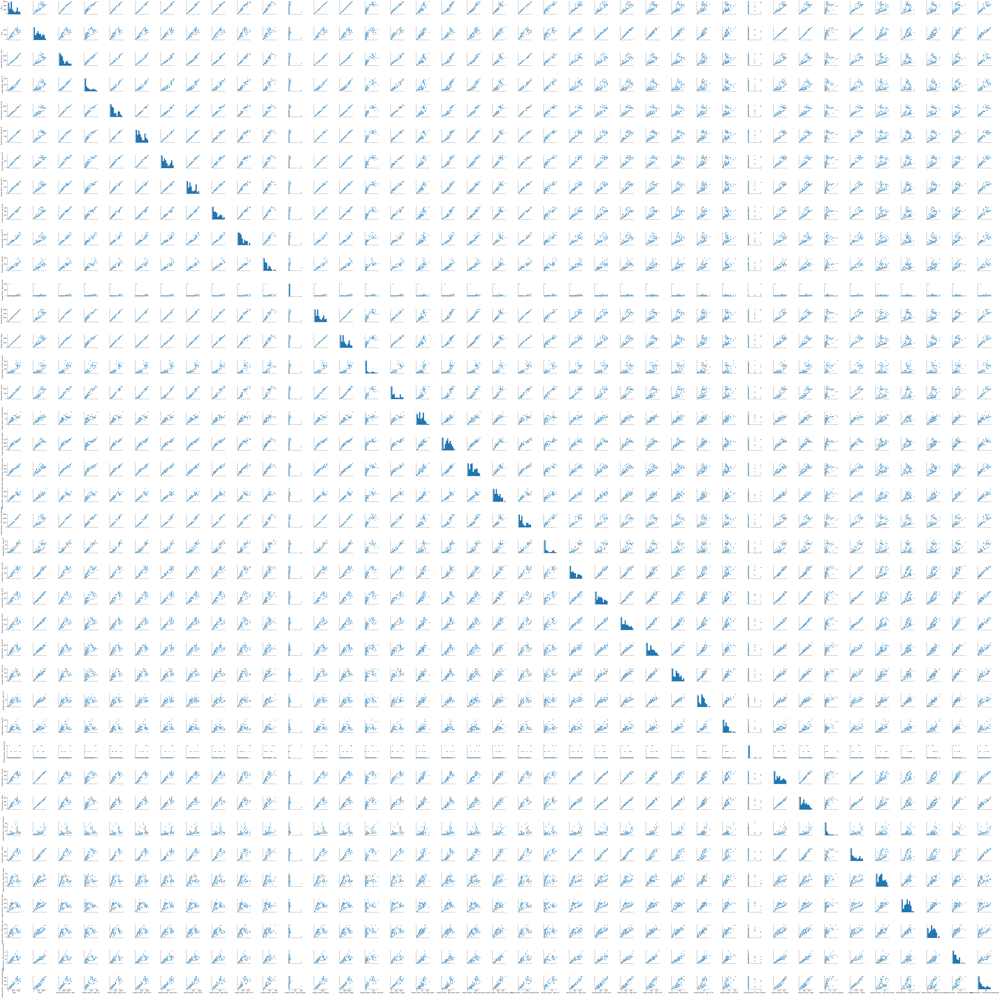

In [219]:
posdata_numeric = pos_data.select_dtypes(include=['float64', 'int64'])
plt.figure(figsize=(20, 10))
sns.pairplot(posdata_numeric)
plt.show()

<Figure size 1440x720 with 0 Axes>

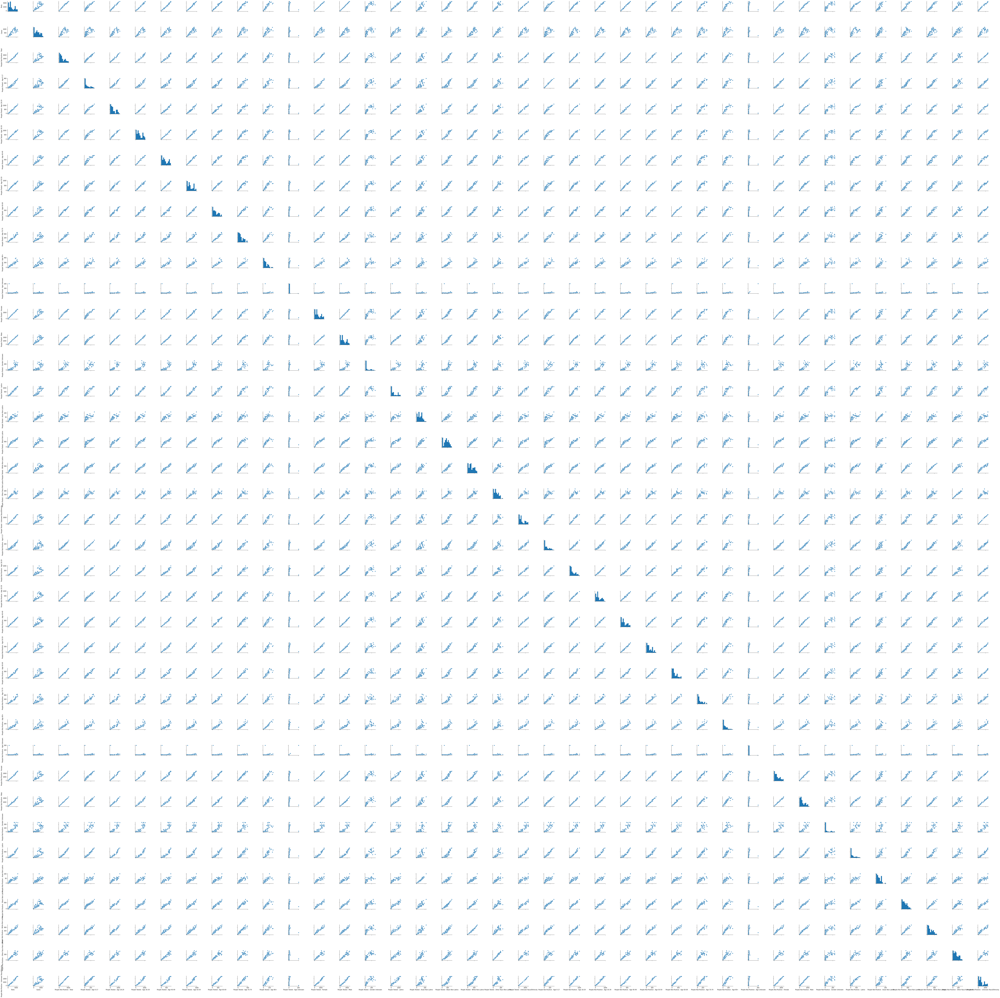

In [220]:
nonposdata_numeric = nonpos_data.select_dtypes(include=['float64', 'int64'])
plt.figure(figsize=(20, 10))
sns.pairplot(nonposdata_numeric)
plt.show()

### Excellent!
Those are slightly less awful to look at! Hopefully! Now let's do some linear regression on this shit.
I mean, first we should probably convert the data to be on the same scale, but we can linear regression _afterwards_.

In [135]:
#####!-! Data Cleaning GET !-!#####
X = data['Tests'].values.reshape(-1,1)
y = data['Cases'].values.reshape(-1,1)

The linear model is: Y = 97.777 + 0.18572X


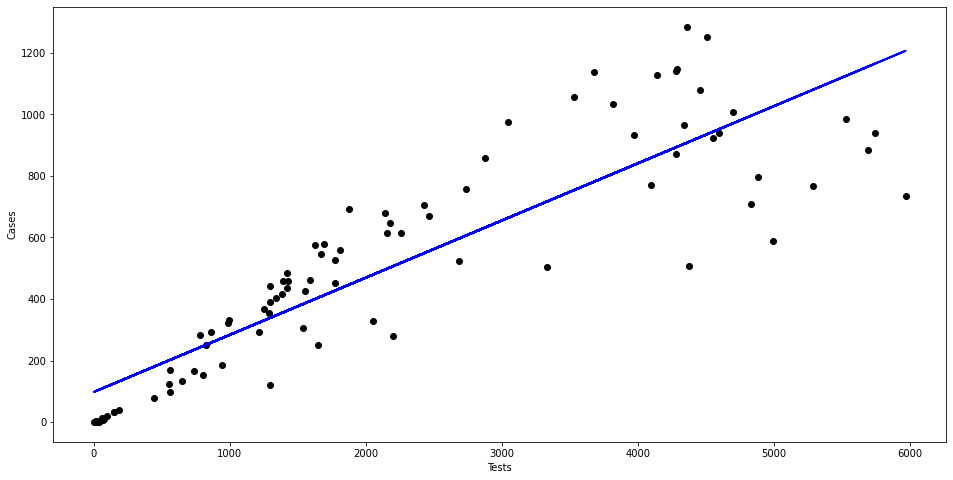

In [136]:
#####!-! Linear Regression DO !-!#####
reg = LinearRegression()
reg.fit(X, y)
predictions = reg.predict(X)
print("The linear model is: Y = {:.5} + {:.5}X".format(reg.intercept_[0], reg.coef_[0][0]))
plt.figure(figsize=(16, 8))
plt.scatter(X, y, c='black')
plt.plot(X, predictions, c='blue', linewidth=2)
plt.xlabel("Tests")
plt.ylabel("Cases")
plt.show()

### The RMSE(Root Mean Square Error) for this linear regression is => 171.8
This... doesn't really work well for our dataset. Too many outliers. We can cut this down by doing Polynomial Regression next!

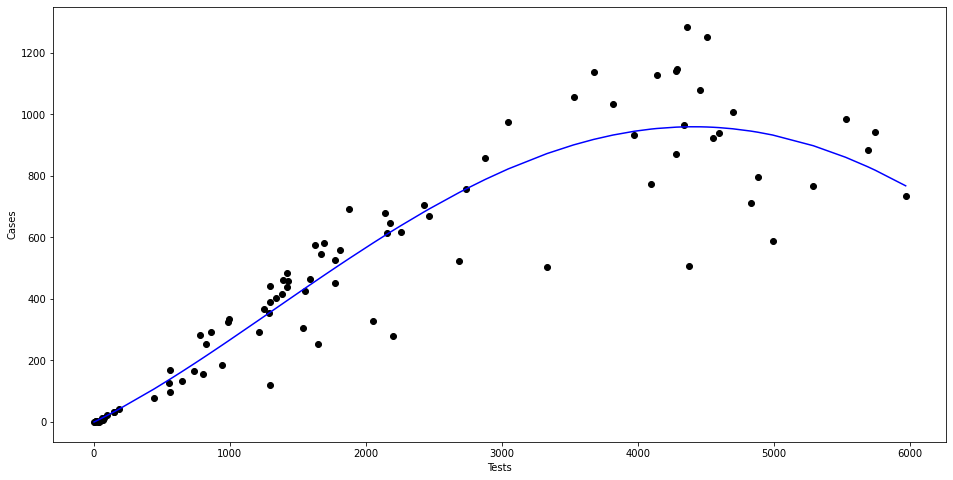

In [137]:
#####!-! Polynomial Regression !-!#####
poly = PolynomialFeatures(degree =4)
X_poly = poly.fit_transform(X)
poly.fit(X_poly, y)
lin2 = LinearRegression()
lin2.fit(X_poly, y)
pred = lin2.predict(X_poly)
new_X, new_y = zip(*sorted(zip(X, pred)))
plt.figure(figsize=(16, 8))
plt.scatter(X, y, c='black')
plt.plot(new_X, new_y, c='blue')
plt.xlabel("Tests")
plt.ylabel("Cases")
plt.show()

### Oh good. Our RMSE becomes => 131.08.
Polynomial Regression does a much better job of showing the relationship between features.

### Polynomial Regression
Whew, that last one was a doozy! Let's do some additional Polynomial Regression using Pearson Correlation on this thing to see if we can get anything of value from it.

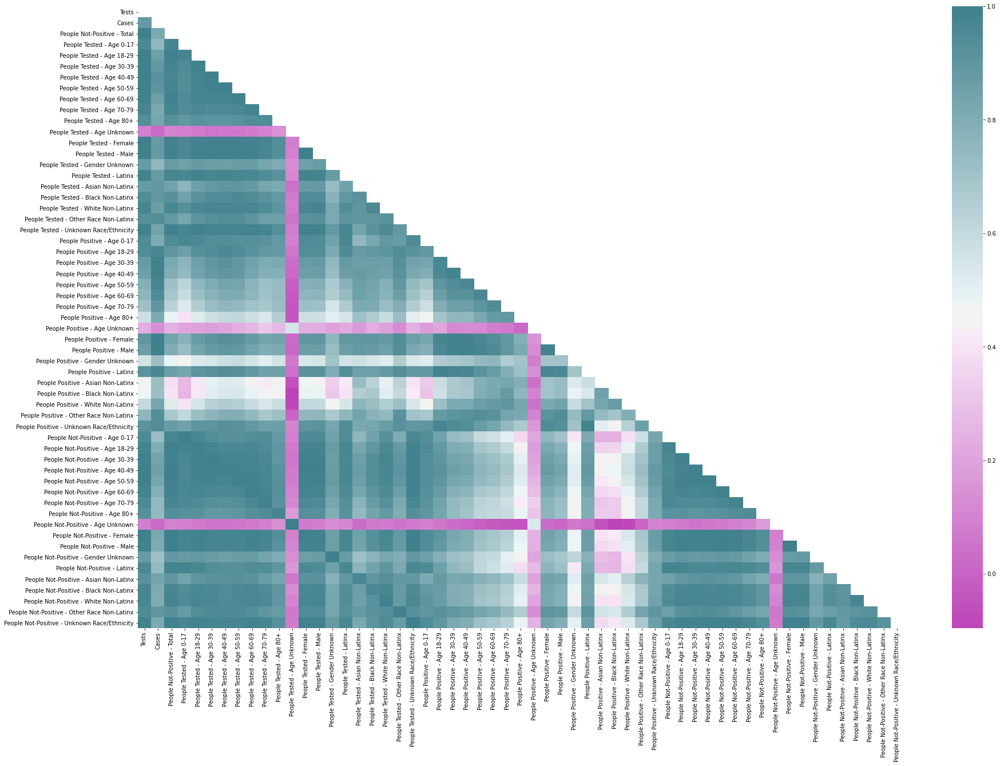

In [212]:
#####!-! Pearson Correlation !-!#####
plt.figure(figsize=(30,20))
corr = data.corr()
mask = np.triu(np.ones_like(corr, dtype=np.bool))
cmap = sns.diverging_palette(310, 210, as_cmap=True)
sns.heatmap(corr, mask=mask, cmap=cmap)

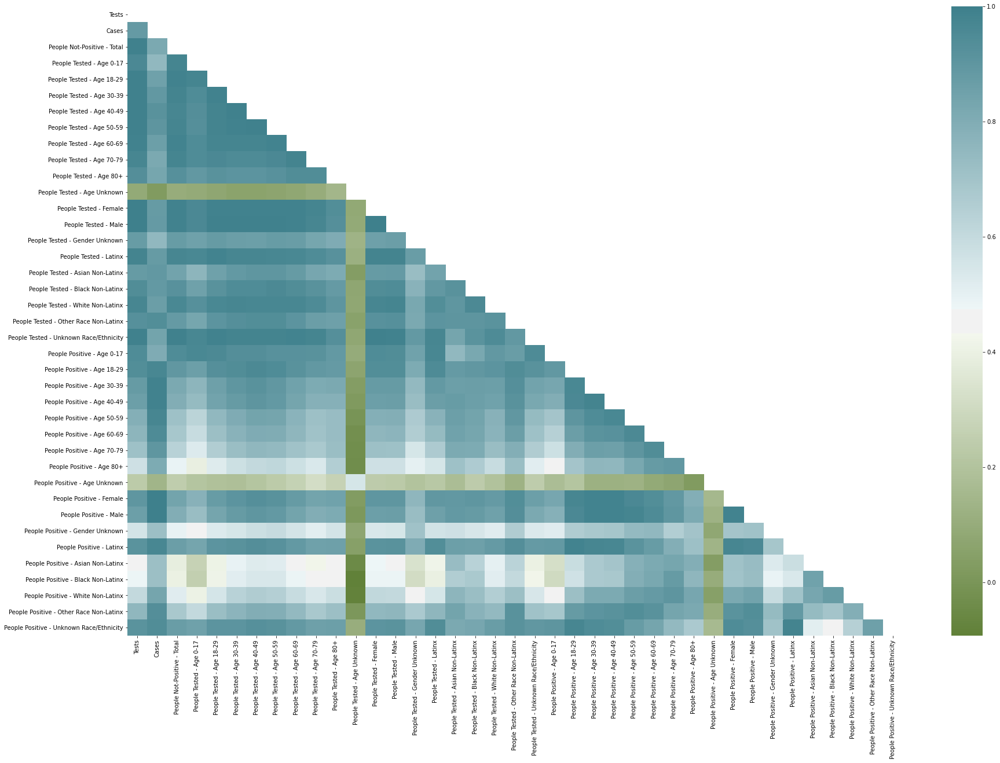

In [210]:
plt.figure(figsize=(30,20))
pos_corr = pos_data.corr()
mask = np.triu(np.ones_like(pos_corr, dtype=np.bool))
cmap = sns.diverging_palette(110, 210, as_cmap=True)
sns.heatmap(pos_corr, mask=mask, cmap=cmap)

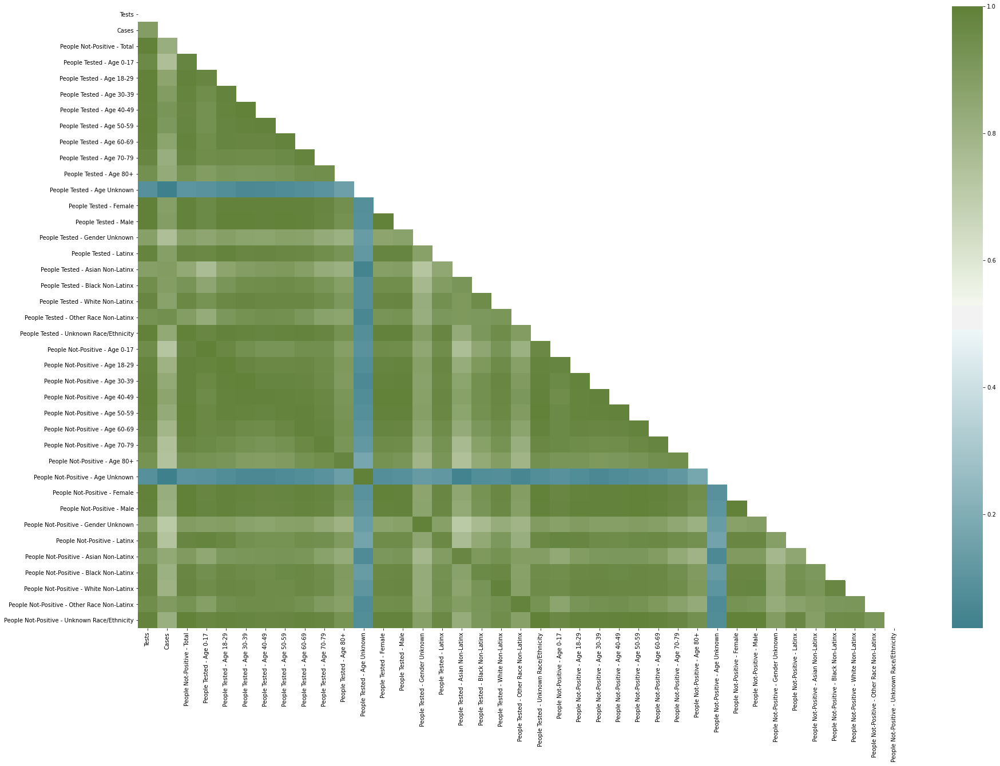

In [211]:
plt.figure(figsize=(30,20))
nonpos_corr = nonpos_data.corr()
mask = np.triu(np.ones_like(nonpos_corr, dtype=np.bool))
cmap = sns.diverging_palette(210, 110, as_cmap=True)
sns.heatmap(nonpos_corr, mask=mask, cmap=cmap)

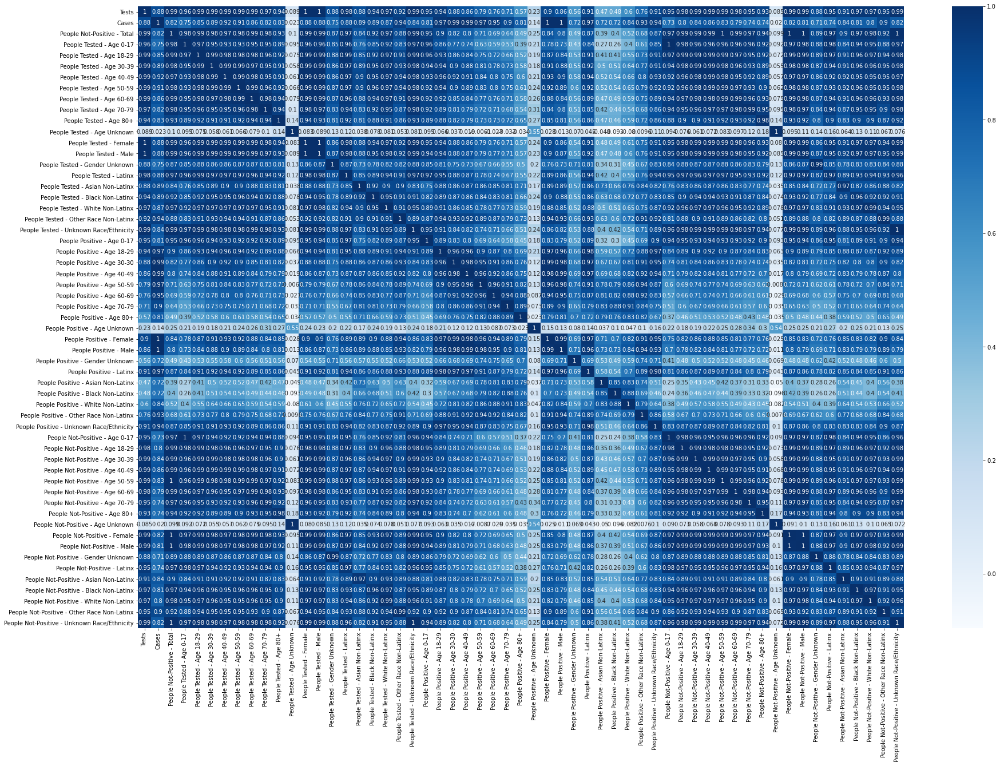

In [139]:
#####!-! Heat Maps !-!#####
plt.subplots(figsize=(30,20))
sns.heatmap(corr, annot=True, cmap=plt.cm.Blues)
plt.show()

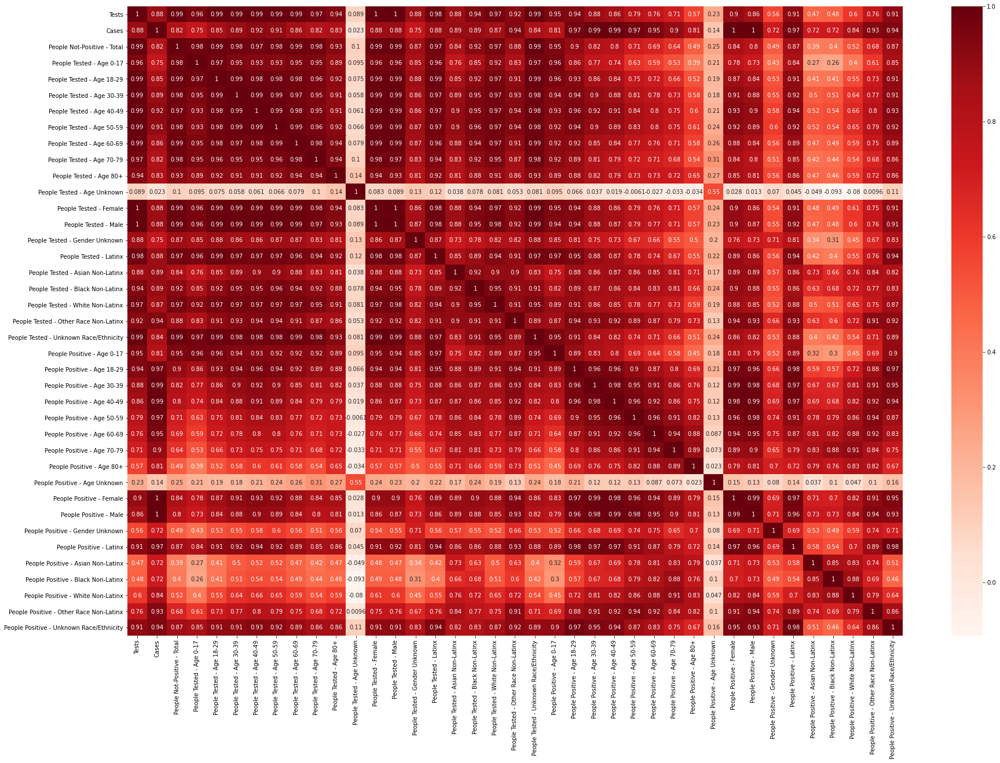

In [216]:
#####!-! Heat Maps !-!#####
plt.subplots(figsize=(30,20))
sns.heatmap(pos_corr, annot=True, cmap=plt.cm.Reds)
plt.show()

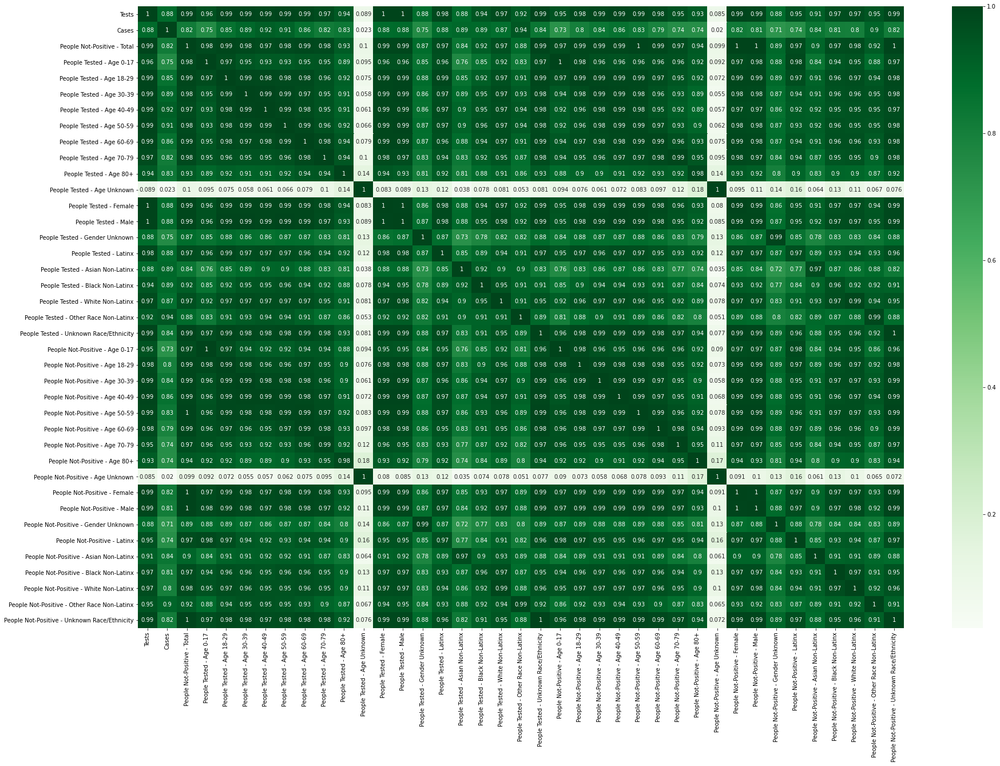

In [218]:
#####!-! Heat Maps !-!#####
plt.subplots(figsize=(30,20))
sns.heatmap(nonpos_corr, annot=True, cmap=plt.cm.Greens)
plt.show()

### Well, the heatmaps _kinda_ helped.
While the initial volley of heatmaps didn't show us _too_ much, the second volley did a pretty good job of showing infectivity amongst different demographics.

In [221]:
%matplotlib inline
sns.pairplot(df, height=2.5)
plt.tight_layout()

## Conclusions
- Linear Regression seems to be an okay way of charting Covid-19 infectivity
- Polynomial Regression is a slightly better way of charting infectivity, as we can better see the relationship between the different features in this dataset.
- Conversely, trying to do things with Pearson Correlation resulted in kind of a jumbled mess, but the heatmaps did an okay job of showing the relationship between testing, cases, and the different demographics.
- This being said, I learned a lot about which methods work best for this kind of dataset and what to and what not to use moving forward.

Future Steps
-------------------
- Write a medium article about this.
- Do this kind of examination but on a much larger COVID-19 Dataset